## Lane Finding Project

The steps of this project are the following:

1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
2. Apply a distortion correction to raw street images.
3. Use color transforms, gradients, etc., to create a thresholded binary image.
4. Apply a perspective transform to rectify binary image ("birds-eye view").
5. Detect lane pixels and fit to find the lane boundary.
6. Determine the curvature of the lane and vehicle position with respect to center.
7. Warp the detected lane boundaries back onto the original image.
8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## 1. Compute the camera calibration matrix and distortion coefficients with 20 chessboard images

In [2]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
from src.helper import * 
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
chess_board_rows = 6
chess_board_cols = 9
obj_points_corners = np.zeros((chess_board_rows*chess_board_cols,3), np.float32)
obj_points_corners[:,:2] = np.mgrid[0:chess_board_cols,0:chess_board_rows].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
obj_points = [] # 3d points in real world space
img_points = [] # 2d points in image plane.

img_addrs = glob.glob('./data/camera_cal/calibration*.jpg')
img = cv2.imread(img_addrs[0])
img_size = (img.shape[1], img.shape[0])

# Step through the list and search for chessboard corners
for frame_name in img_addrs:
    chess_board = cv2.imread(frame_name)
    gray = cv2.cvtColor(chess_board,cv2.COLOR_BGR2GRAY)

    ret, corners = cv2.findChessboardCorners(gray, (chess_board_cols,chess_board_rows), None)

    if ret == True:
        obj_points.append(obj_points_corners)
        img_points.append(corners)
        
        chess_board = cv2.drawChessboardCorners(chess_board, (chess_board_cols,chess_board_rows), corners, ret)
        cv2.imshow('img',chess_board)
        cv2.waitKey(500)
        
cv2. destroyAllWindows() 
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_points, img_points, img_size,None,None)

## 1.2 Test the camera calibration matrix and distortion coefficients with a chessboard image

Text(0.5, 1.0, 'Undistorted image')

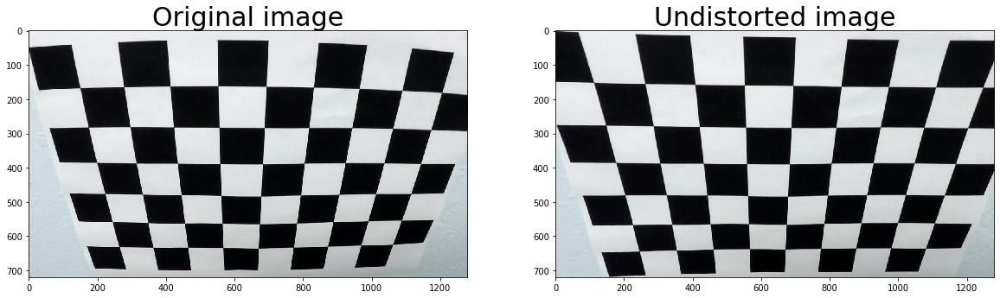

In [3]:
img = cv2.imread('./data/test_cal/test_image.jpg')
undist = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('./data/test_cal/test_undist.jpg',undist)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original image', fontsize=30)
ax2.imshow(undist)
ax2.set_title('Undistorted image', fontsize=30)

## 1.3 Apply a distortion correction to raw street images.

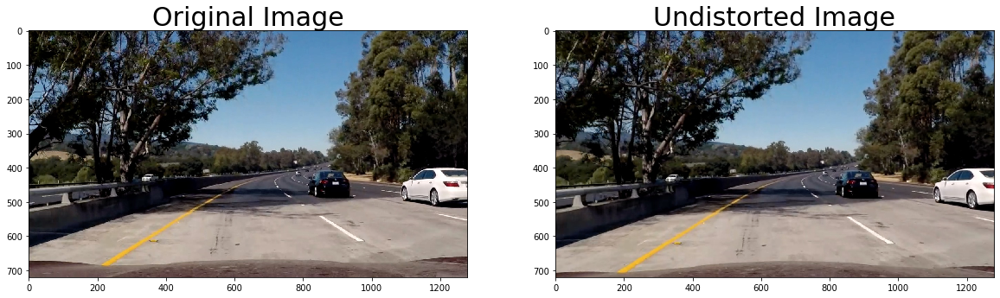

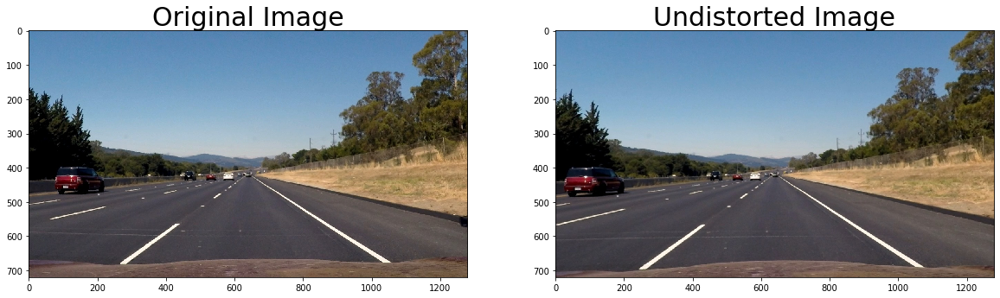

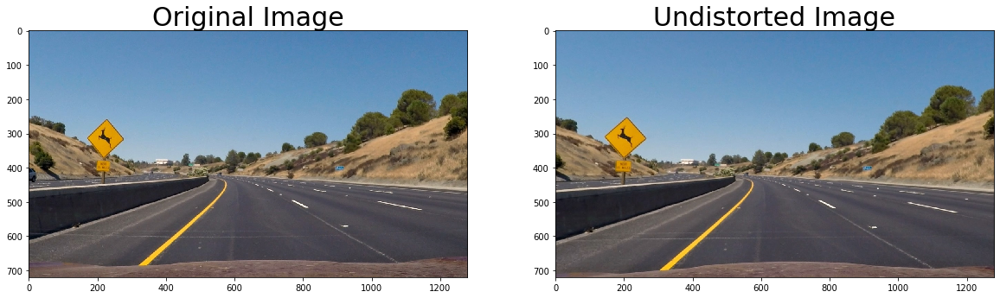

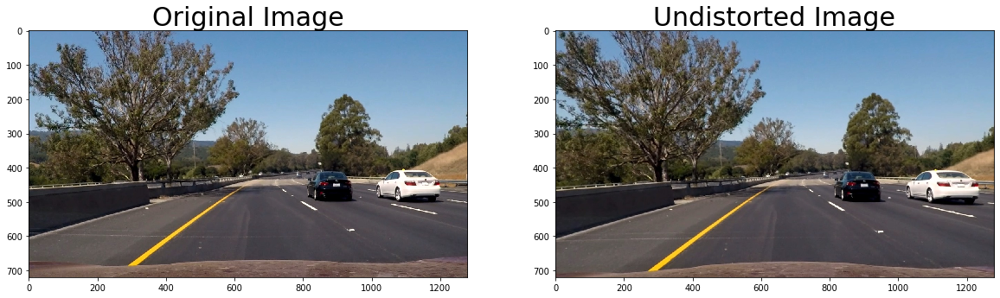

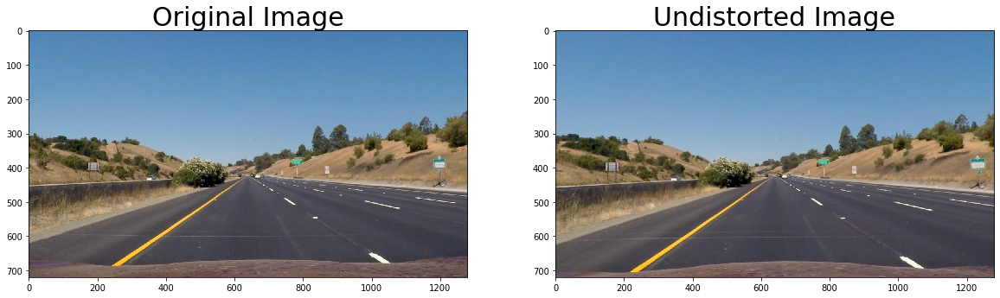

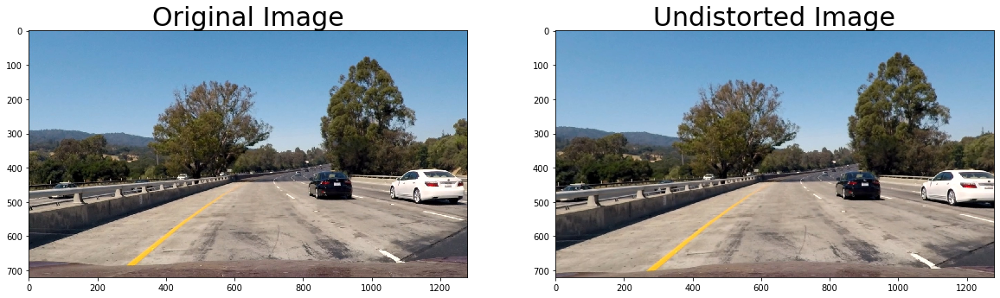

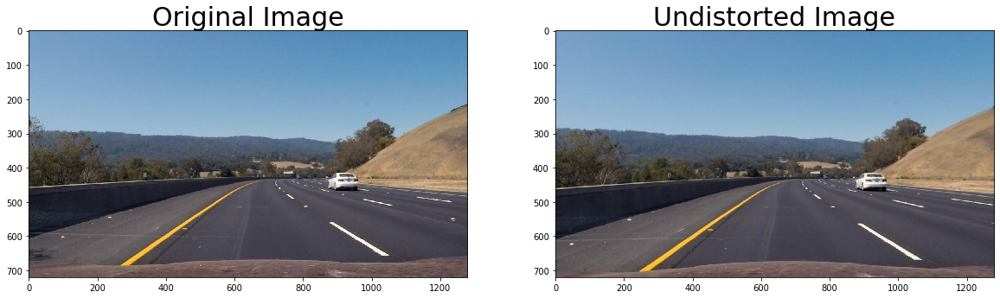

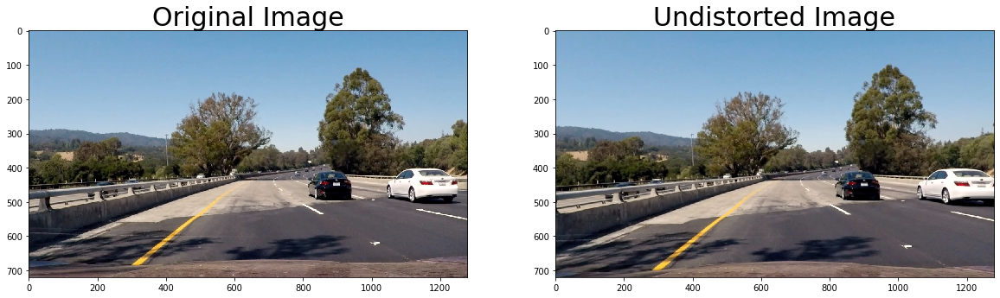

In [4]:
img_addrs = glob.glob('./data/test_street_imgs/*.jpg')
imgs = []
undist_imgs = []
for frame_name in img_addrs:
    img = cv2.imread(frame_name)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    imgs.append(img)
    undist_imgs.append(undist)
    undist_addr = frame_name.split('/')[-1].split('.')[0]
    undist_addr = './data/output/undist/' + undist_addr + '_undist.jpg' 
    cv2.imwrite(undist_addr,undist)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(cv2.cvtColor(undist,cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image', fontsize=30)


## 1.4 Create thresholded binary images from the undistorted stree images.

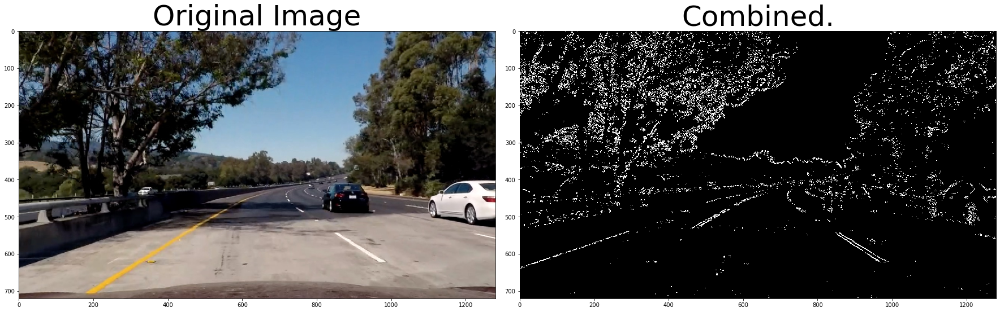

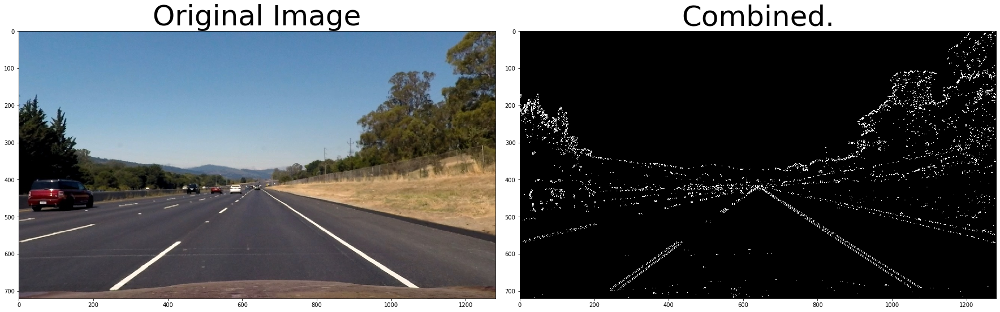

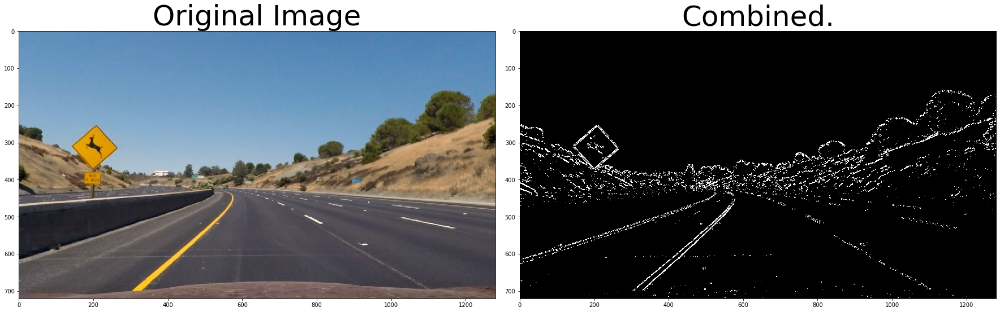

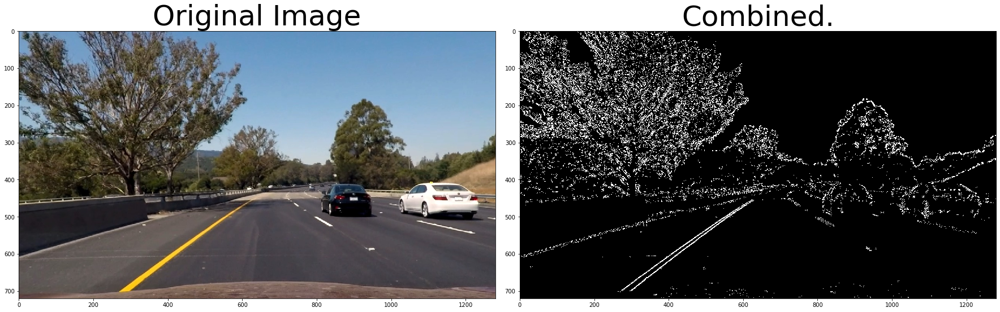

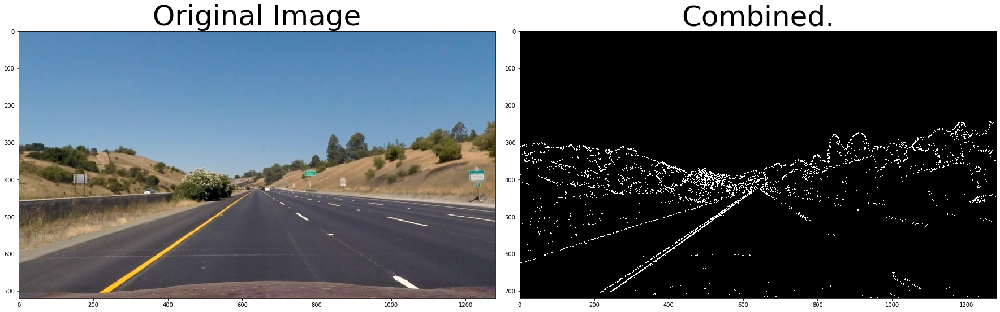

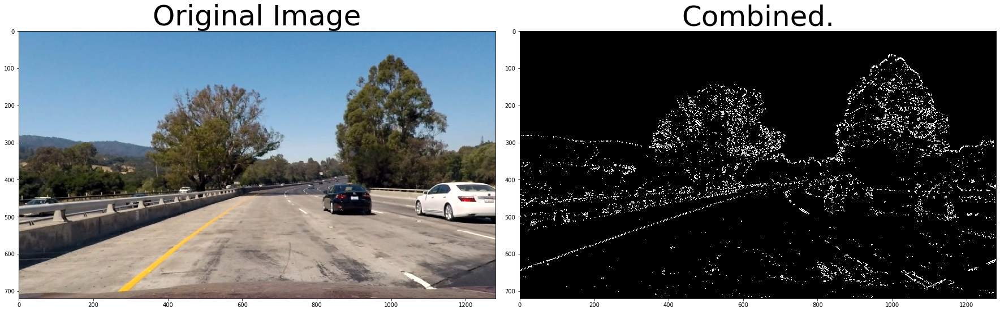

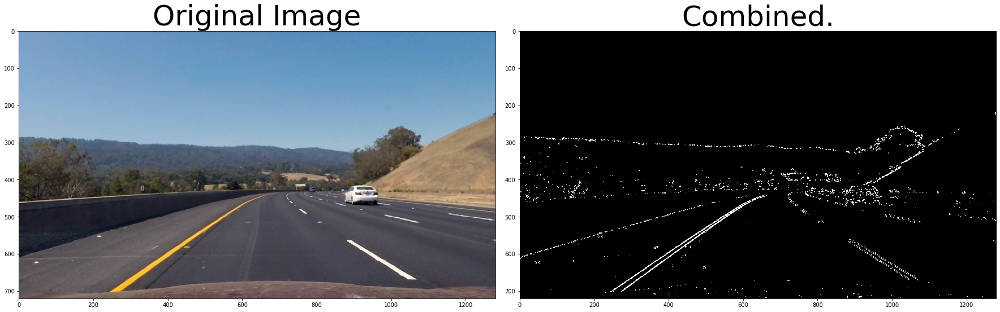

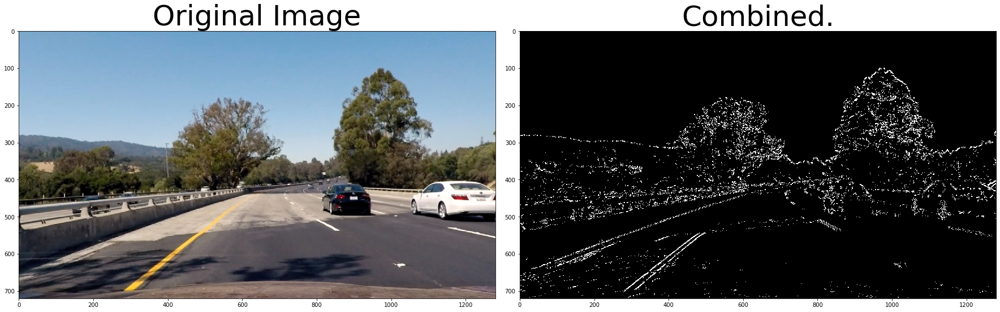

In [5]:
ksize = 3
binary_imgs = []

for undist, frame_name in zip(undist_imgs, img_addrs):
    gradx = abs_sobel_thresh(undist,orient='x',sobel_kernel=ksize,thresh=(20,100))
    grady = abs_sobel_thresh(undist,orient='y',sobel_kernel=ksize,thresh=(20,100))
    dir_binary = dir_thresh(undist, sobel_kernel=ksize, thresh=(0.7, 1.3))
    mag_binary = grad_thresh(undist, sobel_kernel=ksize, thresh=(30, 100))
    s_binary = hls_select(undist, thresh=(170, 255))

    combined = np.zeros_like(dir_binary)
    combined[((gradx==1)&(grady==1)) | ((mag_binary==1)&(dir_binary==1))] = 1
    binary_imgs.append(combined)

    binary_addr = frame_name.split('/')[-1].split('.')[0]
    binary_addr = './data/output/binary/' + binary_addr + '_binary.jpg'
    cv2.imwrite(binary_addr,combined*255)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(undist,cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Combined.', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



In [6]:
# 1.5 Apply a perspective transform to the binary images(bird eye view)

./data/output/bird_eye/test5_birdeye.jpg
./data/output/bird_eye/straight_lines2_birdeye.jpg
./data/output/bird_eye/test2_birdeye.jpg
./data/output/bird_eye/test6_birdeye.jpg
./data/output/bird_eye/straight_lines1_birdeye.jpg
./data/output/bird_eye/test1_birdeye.jpg
./data/output/bird_eye/test3_birdeye.jpg
./data/output/bird_eye/test4_birdeye.jpg


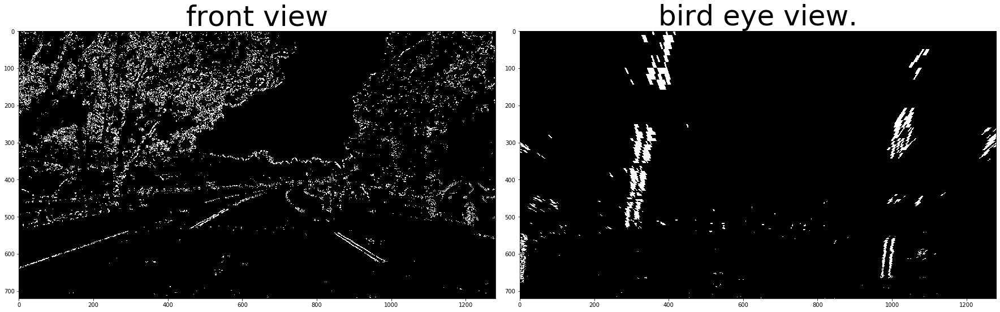

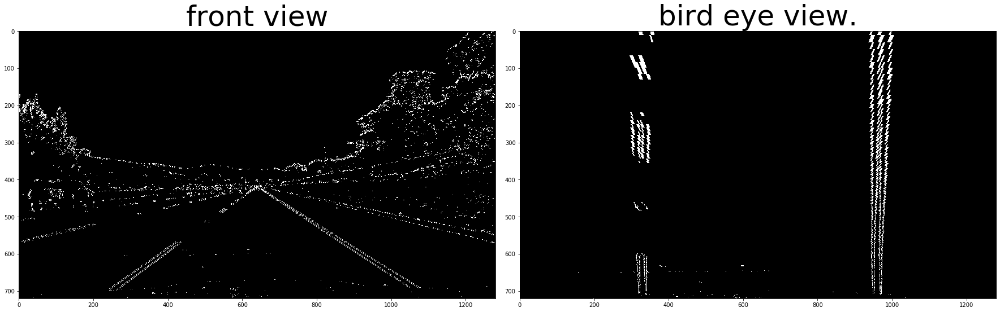

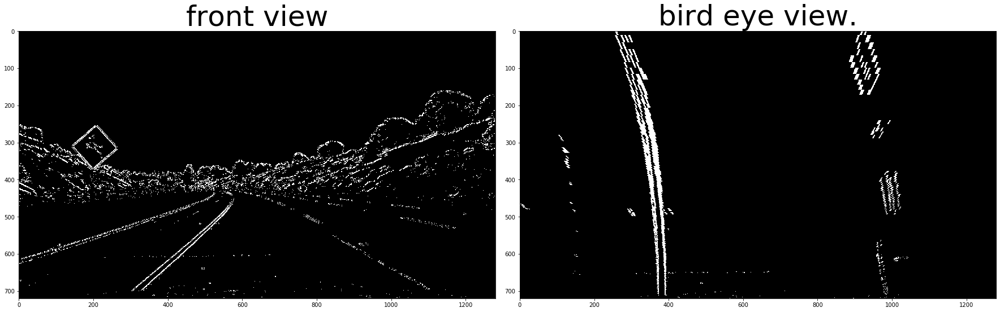

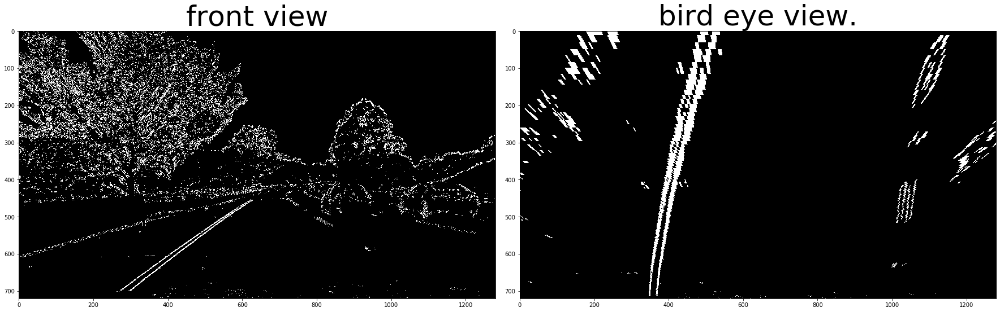

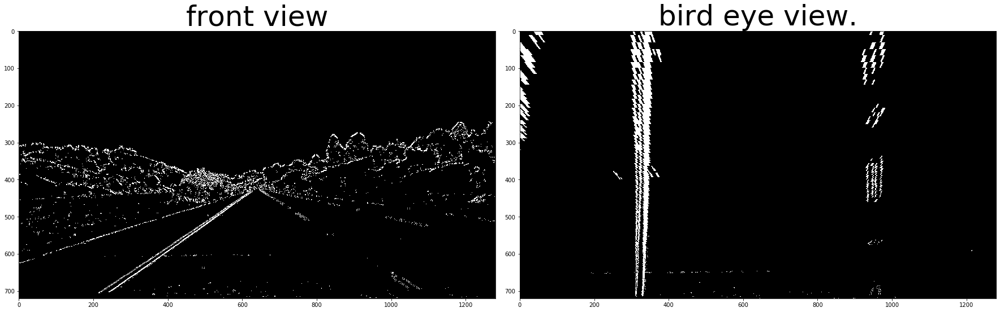

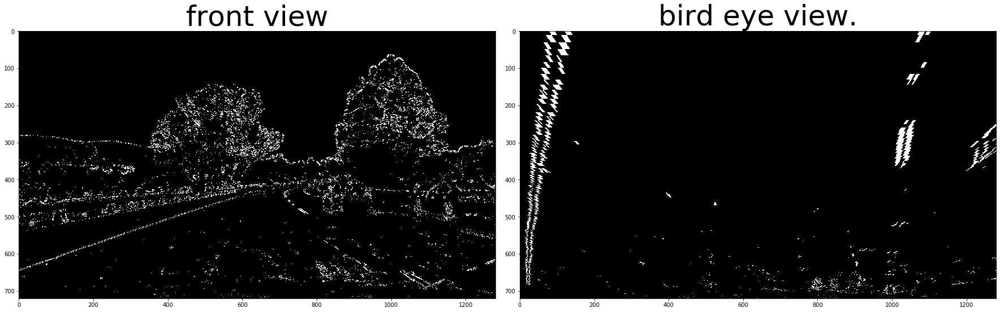

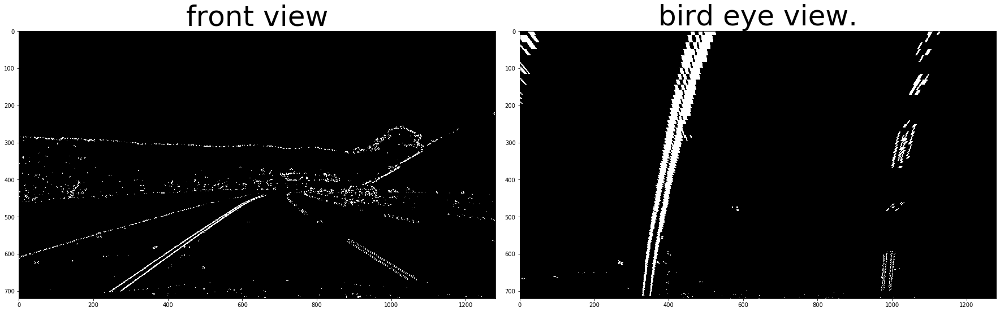

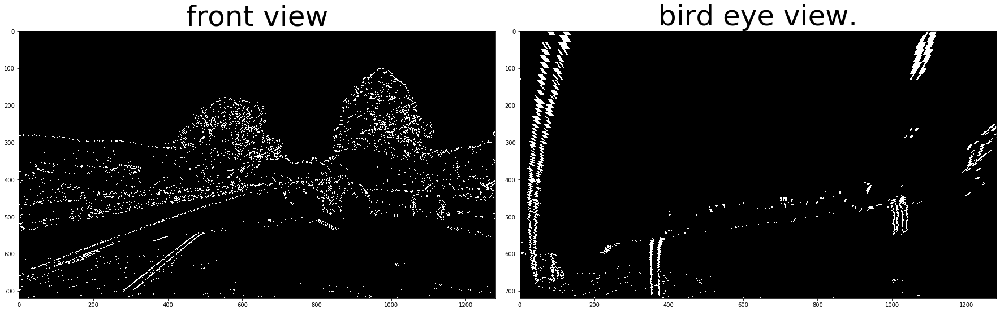

In [16]:
bird_eye_imgs = []

src = np.float32([(580, 460), (205, 720), (1110, 720), (703, 460)])
dst = np.float32([(320, 0), (320, 720), (960, 720), (960, 0)])

for binary_img, frame_name in zip(binary_imgs, img_addrs):
    bird_eye_img = perspective_transform(binary_img, src, dst)
    bird_eye_imgs.append(bird_eye_img)

    bird_eye_addr = frame_name.split('/')[-1].split('.')[0]
    bird_eye_addr = './data/output/bird_eye/' + bird_eye_addr + '_birdeye.jpg'
    print(bird_eye_addr)
    cv2.imwrite(bird_eye_addr, bird_eye_img*255)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary_img, cmap='gray')
    ax1.set_title('front view', fontsize=50)
    ax2.imshow(bird_eye_img, cmap='gray')
    ax2.set_title('bird eye view.', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


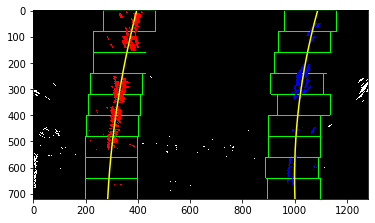

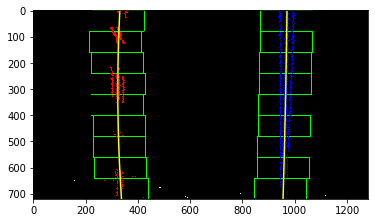

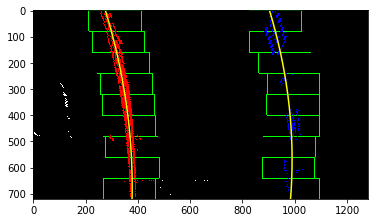

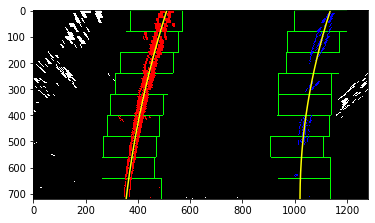

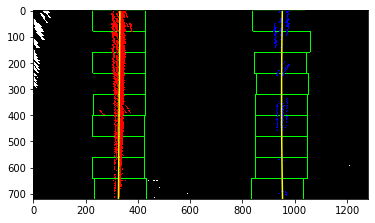

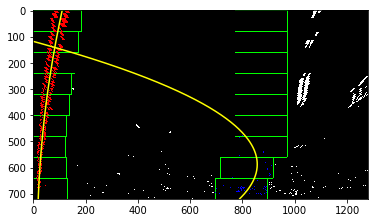

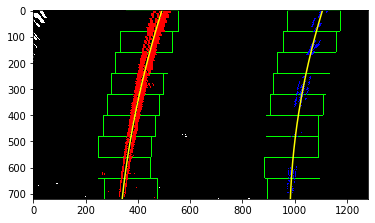

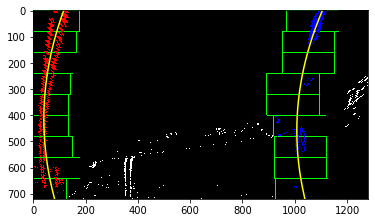

In [8]:
ploty_mul = []
left_fitx_mul = []
right_fitx_mul = []
for bird_eye_img, frame_name in zip(bird_eye_imgs, img_addrs):
    plt.figure()
    ploty, left_fitx, right_fitx, poly_img = fit_polynomial(bird_eye_img)
    ploty_mul.append(ploty)
    left_fitx_mul.append(left_fitx)
    right_fitx_mul.append(right_fitx)
    plt.imshow(poly_img)
    poly_addr = frame_name.split('/')[-1].split('.')[0]
    poly_addr = './data/output/poly/' + poly_addr + '_poly.jpg'
    plt.savefig(poly_addr)


In [9]:
# 1.6 Calculate the curve radius

In [10]:
for bird_eye_img, img in zip(bird_eye_imgs,imgs):
    left_curverad, right_curverad = measure_curvature_real(bird_eye_img)
    print(left_curverad, 'm', right_curverad, 'm')

#lane_center = (right_x_predictions[719] + left_x_predictions[719])/2
#center_offset_pixels = abs(img_size[0]/2 - lane_center)
#center_offset_mtrs = xm_per_pix*center_offset_pixels


1160.9399673226924 m 761.0280929973878 m
2006.14813465665 m 13396.868660318378 m
723.1449760895996 m 618.5525214987324 m
1185.9941258151039 m 736.7679259449895 m
200022.62057866302 m 6500.752907698813 m
1320.1434032137693 m 43.43953860047515 m
1134.5190811332957 m 879.9898713028956 m
373.3064659970568 m 357.11809829218606 m


In [11]:
import numpy as np
dst = np.float32([(580, 460), (205, 720), (1110, 720), (703, 460)])
src = np.float32([(320, 0), (320, 720), (960, 720), (960, 0)])
Minv = cv2.getPerspectiveTransform(src, dst)
num = len(bird_eye_imgs)
for i in range(num):
    bird_eye_img = bird_eye_imgs[i]
    frame_name = img_addrs[i]
    ploty = ploty_mul[i]
    left_fitx = left_fitx_mul[i]
    right_fitx = right_fitx_mul[i]
    undist = undist_imgs[i]
    img = imgs[i]

    warp_zero = np.zeros_like(bird_eye_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))


    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    lane_addr = frame_name.split('/')[-1].split('.')[0]
    lane_addr = './data/output/lane/' + lane_addr + '_lane.jpg'
    cv2.imwrite(lane_addr,result)